In [ ]:
##@Author: Gemma Gordon
##@Date: February 2023
# Script to find individual contributions of each CDR loop to the paratope/number of interactions contributed per CDR

Use summary data to find number of interactions contributed per CDR for each complex in the Abs and sdAbs datasets

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [2]:
import ast

In [3]:
plt.rcParams['figure.dpi'] = 1200

Load in data

In [4]:
abs_summary = pd.read_csv('Dataset_flAbs_summary.csv')
sdabs_summary = pd.read_csv('Dataset_sdAbs_summary.csv')

In [4]:
abs_summary.columns

Index(['pdb', 'antigen_chain', 'antibody_chain', 'antigen_sequence',
       'antibody_sequence', 'cdr_sequence', 'epitope_dis',
       'epitope_dis_interactions', 'paratope_dis', 'paratope_dis_interactions',
       'epitope_arp', 'epitope_arp_interactions', 'paratope_arp',
       'paratope_arp_interactions', 'canonical_form_CDRH1',
       'canonical_form_CDRH2'],
      dtype='object')

In [5]:
list(ast.literal_eval(abs_summary['paratope_dis_interactions'][0]).items())[1]

('B',
 {'D_38': 1,
  'Y_56': 2,
  'S_107': 2,
  'N_108': 4,
  'R_109': 4,
  'W_114': 8,
  'F_116': 2})

In [5]:
abs_ints_dis_vh = [list(ast.literal_eval(d).items())[0][1] for d in abs_summary['paratope_dis_interactions']]
abs_ints_dis_vl = [list(ast.literal_eval(d).items())[1][1] for d in abs_summary['paratope_dis_interactions']]
sdabs_ints_dis = [ast.literal_eval(s) for s in sdabs_summary['paratope_dis_interactions']]
sdabs_ints_arp = [ast.literal_eval(s) for s in sdabs_summary['paratope_arp_interactions']]

In [6]:
# debug for 2 missing arpeggio results (failed)
abs_ints_arp_vh = []
for d in abs_summary['paratope_arp_interactions']:
    try:
        d = list(ast.literal_eval(d).items())[0]
        abs_ints_arp_vh.append(d[1])
    except:
        d = d 
        print(d)

# debug for 2 missing arpeggio results (failed)
abs_ints_arp_vl = []
for d in abs_summary['paratope_arp_interactions']:
    try:
        d = list(ast.literal_eval(d).items())[1]
        abs_ints_arp_vl.append(d[1])
    except:
        d = d 
        print(d)

nan
nan
nan
nan


Set definitions for which residue numbers are CDR residues (IMGT numbering definition)

https://www.imgt.org/IMGTScientificChart/Nomenclature/IMGT-FRCDRdefinition.html

In [7]:
# for Abs assume first chain in dict is heavy (because it is)

h1 = l1 = [str(i) for i in np.arange(27, 39, 1)]
h2 = l2 = [str(i) for i in np.arange(56, 66, 1)]
h3 = l3 = [str(i) for i in np.arange(105, 118, 1)]

print('H1:', h1)
print('H2:', h2)
print('H3:', h3)

H1: ['27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38']
H2: ['56', '57', '58', '59', '60', '61', '62', '63', '64', '65']
H3: ['105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117']


Parse each row in column and determine how many interactions from CDRH1, H2, H3

In [8]:
loop_defs = {'H1':h1, 'H2':h2, 'H3':h3, 'L1':l1, 'L2':l2, 'L3':l3}

In [9]:
def count_cdr_ints(dict_list, loop_defs, loops):
    # input list of loops (h1, h2, h3) or (l1, l2, l3)

    cdr1_totals, cdr2_totals, cdr3_totals = [],[],[]
    for item in dict_list:
        for key, value in zip(item.keys(), item.values()):
            # for each entry in dict check if number in h1/h2/h3, if yes, add to total num interactions for that loop
            if key.split('_')[1] in loop_defs[loops[0]]:
                cdr1_totals.append(value)
            if key.split('_')[1] in loop_defs[loops[1]]:
                cdr2_totals.append(value)
            if key.split('_')[1] in loop_defs[loops[2]]:
                cdr3_totals.append(value)
    
    return {loops[0]: cdr1_totals, loops[1]: cdr2_totals, loops[2]: cdr3_totals}

In [10]:
abs_dis_counts_vh = count_cdr_ints(abs_ints_dis_vh, loop_defs, loops=['H1', 'H2', 'H3'])
abs_dis_counts_vl = count_cdr_ints(abs_ints_dis_vl, loop_defs, loops=['L1', 'L2', 'L3'])

abs_arp_counts_vh = count_cdr_ints(abs_ints_arp_vh, loop_defs, loops=['H1', 'H2', 'H3'])
abs_arp_counts_vl = count_cdr_ints(abs_ints_arp_vl, loop_defs, loops=['L1', 'L2', 'L3'])

In [11]:
sdabs_dis_counts = count_cdr_ints(sdabs_ints_dis, loop_defs, loops=['H1', 'H2', 'H3'])
sdabs_arp_counts = count_cdr_ints(sdabs_ints_arp, loop_defs, loops=['H1', 'H2', 'H3'])

Plot totals for H1/H2/H3 as proportion of all CDRs

In [12]:
def plot_total_num_per_cdr(results_dict, loops, title, color):

    count_all = sum(pd.Series(results_dict[loop]).describe()[0] for loop in list(results_dict.keys()))
    print(count_all)

    prop_results = dict()
    for loop in list(results_dict.keys()):
        total = pd.Series(results_dict[loop]).describe()[0]
        print(loop, total)
        total_proportion = total / count_all 
        prop_results[loop] = total_proportion

    plt.figure()
    plt.title(str(title + ': proportion of interactions per CDR loop'))
    values = list(prop_results.values())
    plt.bar(range(len(prop_results)), values, tick_label=list(results_dict.keys()), color=color)
    plt.xticks(rotation=45)
    plt.ylim(0, 0.5, 0.1)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()

    return 


10589.0
H1 2439.0
H2 3123.0
H3 5027.0


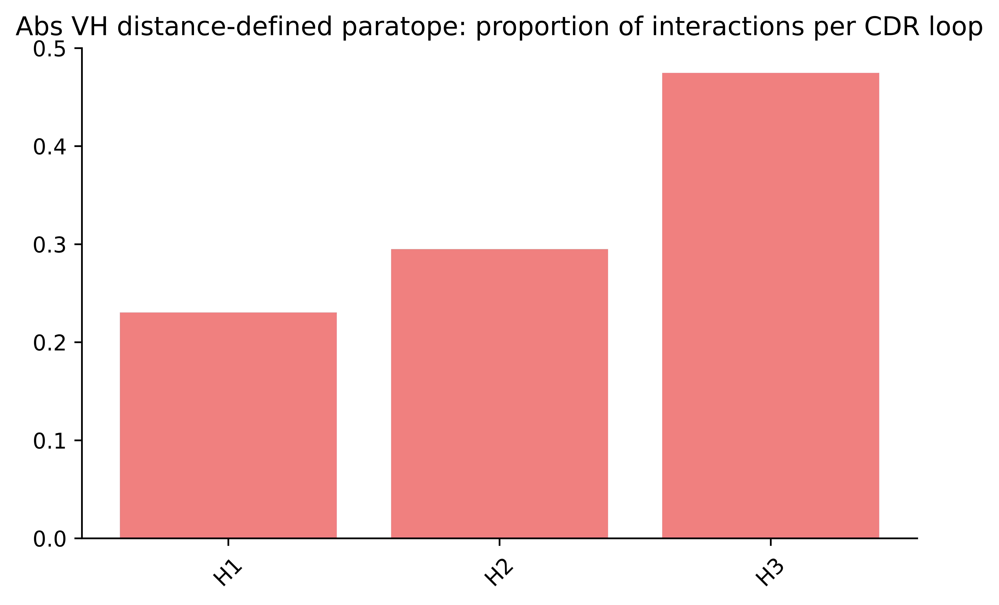

In [13]:
plot_total_num_per_cdr(abs_dis_counts_vh, loops=['H1','H2','H3'], title='Abs VH distance-defined paratope', color='lightcoral')

5842.0
L1 2420.0
L2 564.0
L3 2858.0


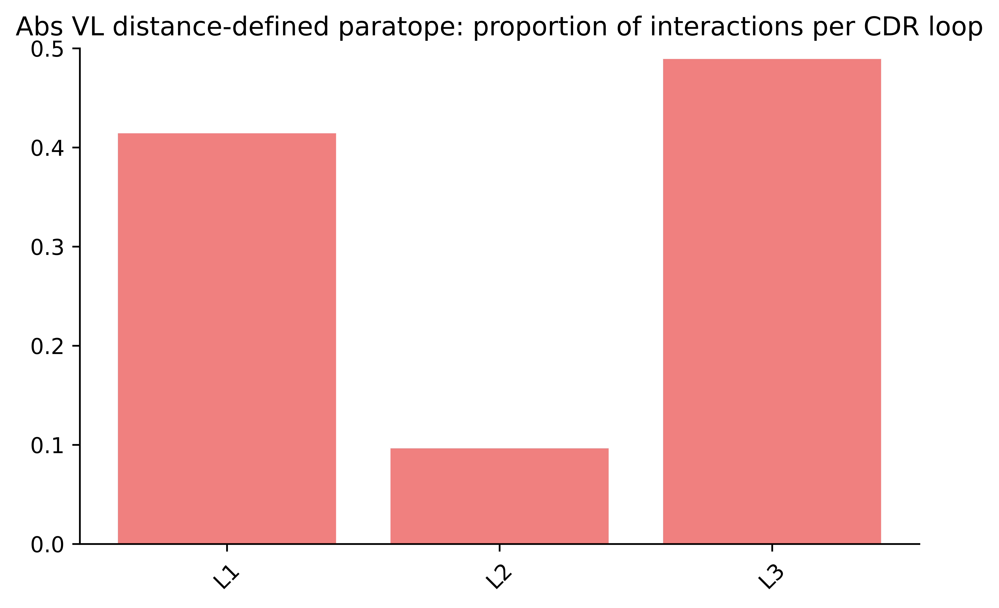

In [14]:
plot_total_num_per_cdr(abs_dis_counts_vl, loops=['L1','L2','L3'], title='Abs VL distance-defined paratope', color='lightcoral')

8200.0
H1 1800.0
H2 2388.0
H3 4012.0


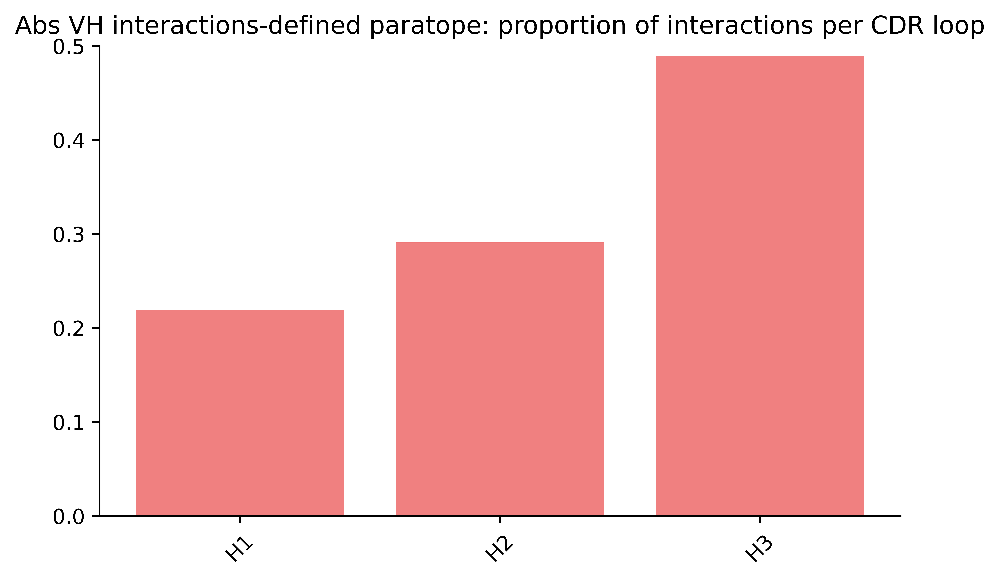

In [15]:
plot_total_num_per_cdr(abs_arp_counts_vh, loops=['H1','H2','H3'], title='Abs VH interactions-defined paratope', color='lightcoral')

4213.0
L1 1686.0
L2 417.0
L3 2110.0


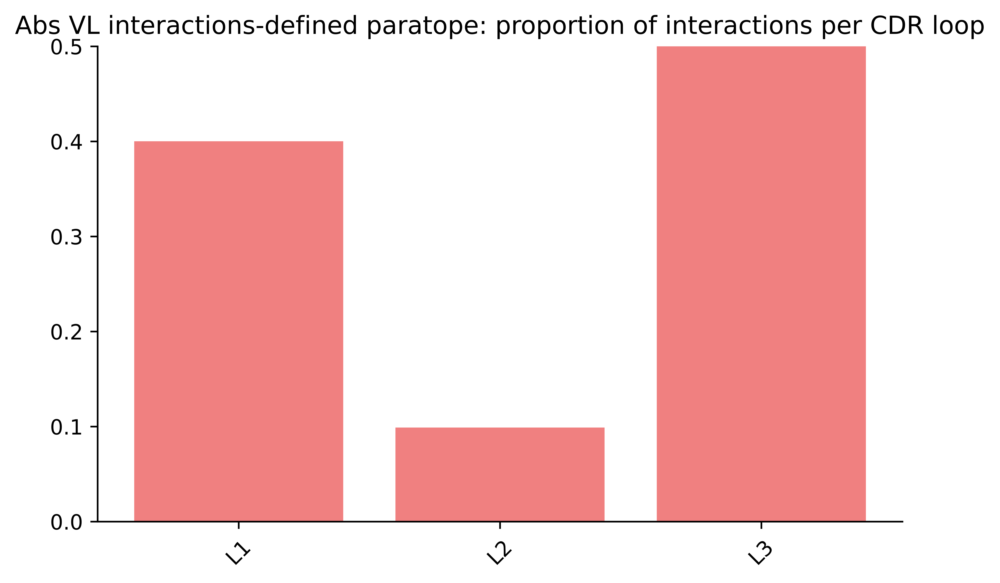

In [16]:
plot_total_num_per_cdr(abs_arp_counts_vl, loops=['L1','L2','L3'], title='Abs VL interactions-defined paratope', color='lightcoral')

4797.0
H1 949.0
H2 1050.0
H3 2798.0


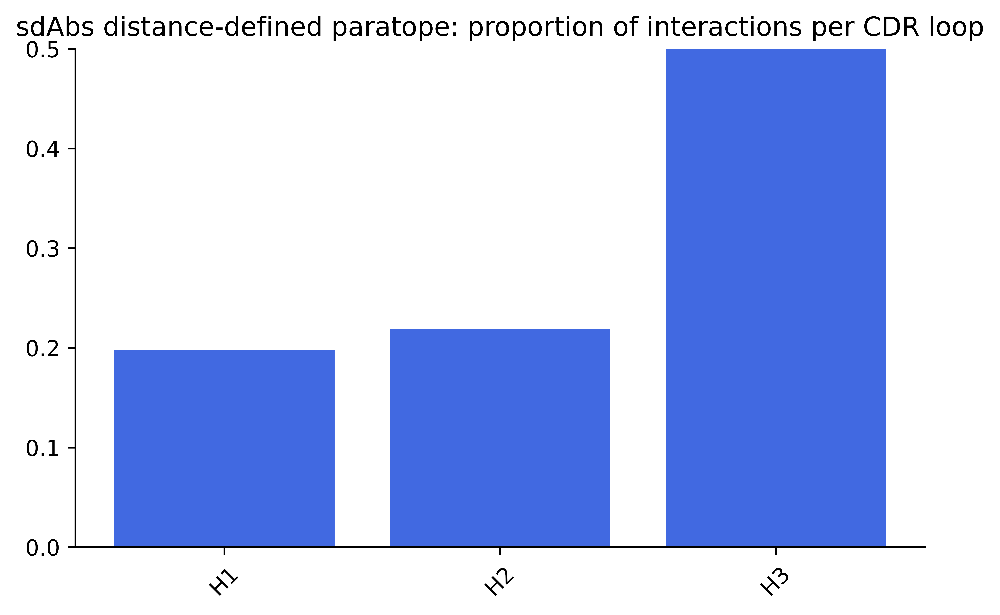

In [17]:
plot_total_num_per_cdr(sdabs_dis_counts, loops=['H1','H2','H3'], title='sdAbs distance-defined paratope', color='royalblue')

3724.0
H1 717.0
H2 739.0
H3 2268.0


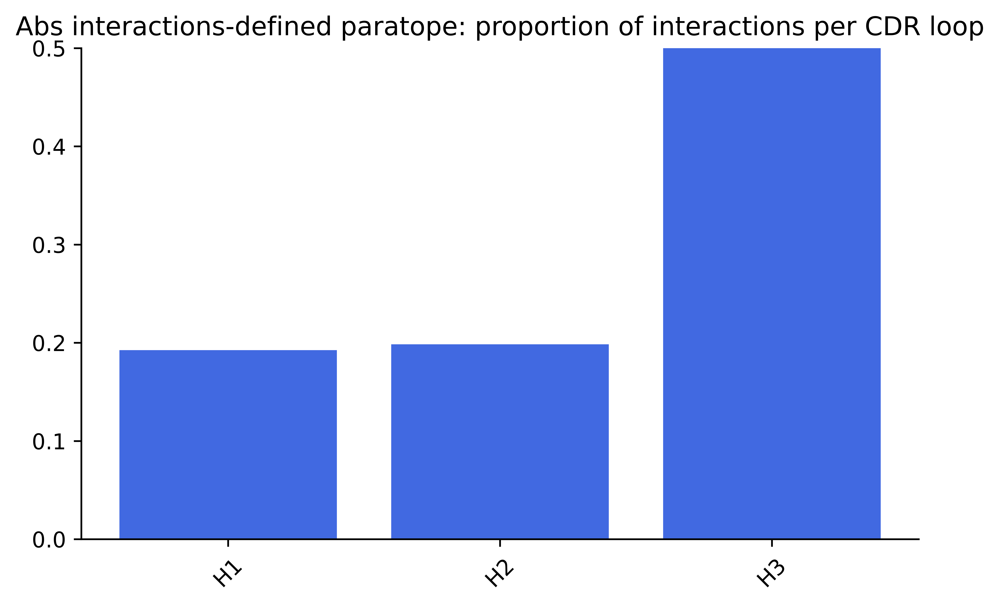

In [18]:
plot_total_num_per_cdr(sdabs_arp_counts, loops=['H1','H2','H3'], title='Abs interactions-defined paratope', color='royalblue')

Above suggests that sdAbs depend more on H3 to contribute interactions but should normalise for loop length since H3 longer in sdAbs than Abs

### Normalise for average CDR length

Get CDR lengths for Abs and sdAbs datasets

In [19]:
abs_summary['cdr_sequence'][0]

"{'CDRH1': 'GYTFTSDW', 'CDRH2': 'IIPSYGRA', 'CDRH3': 'ARERGDGYFDY', 'CDRL1': 'QSIGTD', 'CDRL2': 'YAS', 'CDRL3': 'QQSNRWPFT', 'CDRH': 'GYTFTSDWIIPSYGRAARERGDGYFDY', 'CDRL': 'QSIGTDYASQQSNRWPFT', 'CDRHL': 'GYTFTSDWIIPSYGRAARERGDGYFDYQSIGTDYASQQSNRWPFT'}"

In [20]:
# get CDR lengths
def get_cdr_lengths(summary_df):

    h1_lens, h2_lens, h3_lens, l1_lens, l2_lens, l3_lens = [],[],[],[],[],[]
    
    for row in summary_df['cdr_sequence']:

        cdr_dict = ast.literal_eval(row) # read row as dict
        # extract CDR lengths per loop from dict keys
        h1_lens.append(len(cdr_dict['CDRH1']))
        h2_lens.append(len(cdr_dict['CDRH2']))
        h3_lens.append(len(cdr_dict['CDRH3']))

        try: # if abs
            l1_lens.append(len(cdr_dict['CDRL1']))
            l2_lens.append(len(cdr_dict['CDRL2']))
            l3_lens.append(len(cdr_dict['CDRL3']))
        except: # if nbs
            l1_lens, l2_lens, l3_lens = [],[],[]

    cdr_lens_dict = {'H1':h1_lens, 'H2':h2_lens, 'H3':h3_lens, 'L1':l1_lens, 'L2':l2_lens, 'L3':l3_lens}

    return cdr_lens_dict

In [21]:
abs_cdr_lens = get_cdr_lengths(abs_summary)

In [22]:
print('Abs H1 mean:', np.mean(abs_cdr_lens['H1']))
print('Abs H2 mean:', np.mean(abs_cdr_lens['H2']))
print('Abs H3 mean:', np.mean(abs_cdr_lens['H3']))

print('Abs L1 mean:', np.mean(abs_cdr_lens['L1']))
print('Abs L2 mean:', np.mean(abs_cdr_lens['L2']))
print('Abs L3 mean:', np.mean(abs_cdr_lens['L3']))

abs_means_vh = [np.mean(abs_cdr_lens['H1']), np.mean(abs_cdr_lens['H2']), np.mean(abs_cdr_lens['H3'])]
abs_means_vl = [np.mean(abs_cdr_lens['L1']), np.mean(abs_cdr_lens['L2']), np.mean(abs_cdr_lens['L3'])]

Abs H1 mean: 8.201793721973095
Abs H2 mean: 7.811659192825112
Abs H3 mean: 13.939461883408072
Abs L1 mean: 7.085201793721973
Abs L2 mean: 3.0190582959641254
Abs L3 mean: 9.190582959641256


In [23]:
sdabs_cdr_lens = get_cdr_lengths(sdabs_summary)

In [24]:
print('sdAbs H1 mean:', np.mean(sdabs_cdr_lens['H1']))
print('sdAbs H2 mean:', np.mean(sdabs_cdr_lens['H2']))
print('sdAbs H3 mean:', np.mean(sdabs_cdr_lens['H3']))

sdabs_means = [np.mean(sdabs_cdr_lens['H1']), np.mean(sdabs_cdr_lens['H2']), np.mean(sdabs_cdr_lens['H3'])]

sdAbs H1 mean: 8.046376811594202
sdAbs H2 mean: 7.698550724637681
sdAbs H3 mean: 15.539130434782608


In [25]:
def plot_normalised_totals(results_dict, means, title, color): # NOTE not average per complex

    count_all = sum(pd.Series(results_dict[loop]).describe()[0] for loop in list(results_dict.keys()))
    print(count_all)

    # count all norm = total counts of all CDR loops summed, each normalised by dividing by mean loop length
    count_all_norm = [] 
    for loop, mean in zip(list(results_dict.keys()), means):
        total = pd.Series(results_dict[loop]).describe()[0]
        print(loop, total)
        total_normalised = (total / mean) 
        print(total_normalised)
        count_all_norm.append(total_normalised)
    
    print(count_all_norm)
    print(sum(count_all_norm))
    
    results = dict()
    for loop, total_normalised in zip(list(results_dict.keys()), count_all_norm):
        results[loop] = total_normalised / sum(count_all_norm)

    plt.figure(figsize=(6,6))
    plt.title(str(title + ': proportion of interactions per CDR loop'))
    values = list(results.values())
    plt.bar(range(len(results)), values, tick_label=['H1', 'H2', 'H3'], color=color)
    plt.xticks(rotation=45)
    plt.ylim(0, 0.5, 0.1)
    plt.xlabel('CDR loop')
    plt.ylabel('Total number of interactions / average loop length')
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()

    return 

In [26]:
plot_normalised_totals(abs_dis_counts_vh, abs_means_vh, title='Abs VH distance-defined paratope', color='lightcoral')

10589.0
H1 2439.0
297.3739748496446
H2 3123.0
399.7870264064294
H3 5027.0
360.6308508927135
[297.3739748496446, 399.7870264064294, 360.6308508927135]
1057.7918521487875


In [27]:
plot_normalised_totals(abs_dis_counts_vl, abs_means_vl, title='Abs VL distance-defined paratope', color='lightcoral')

5842.0
L1 2420.0
341.55696202531647
L2 564.0
186.8132194578537
L3 2858.0
310.9704806050256
[341.55696202531647, 186.8132194578537, 310.9704806050256]
839.3406620881958


In [28]:
plot_normalised_totals(abs_arp_counts_vh, abs_means_vh, title='Abs VH interactions-defined paratope', color='lightcoral')

8200.0
H1 1800.0
219.46418808091852
H2 2388.0
305.69690011481055
H3 4012.0
287.81598841885153
[219.46418808091852, 305.69690011481055, 287.81598841885153]
812.9770766145805


In [29]:
plot_normalised_totals(abs_arp_counts_vl, abs_means_vl, title='Abs VL interactions-defined paratope', color='lightcoral')

4213.0
L1 1686.0
237.96075949367088
L2 417.0
138.12253991830673
L3 2110.0
229.5828250792876
[237.96075949367088, 138.12253991830673, 229.5828250792876]
605.6661244912652


In [30]:
plot_normalised_totals(sdabs_dis_counts, sdabs_means, title='sdAbs distance-defined paratope', color='royalblue')

4797.0
H1 949.0
117.94128242074929
H2 1050.0
136.38930722891567
H3 2798.0
180.06155567991047
[117.94128242074929, 136.38930722891567, 180.06155567991047]
434.39214532957544


In [31]:
plot_normalised_totals(sdabs_arp_counts, sdabs_means, title='sdAbs interactions-defined paratope', color='royalblue')

3724.0
H1 717.0
89.10842939481269
H2 739.0
95.99209337349397
H3 2268.0
145.9541130386122
[89.10842939481269, 95.99209337349397, 145.9541130386122]
331.0546358069189


Get average interactions per loop; normalised per complex

In [32]:
def plot_normalised_per_complex(counts, cdr_lens, title, color, loops): 

    # for each loop, go through each item in count and cdr length and divide count/cdr len
    # get a distribution of values for each loop
    # get the average number of interactions per loop 

    norm_counts_per_loop = dict()
    mean_counts_per_complex_per_loop = dict()

    # count all norm = total counts of all CDR loops summed, each normalised by dividing by mean loop length
    for loop in loops:
        normalised_counts = []
        for count, cdr_len in zip(counts[loop], cdr_lens[loop]):
            normalised_count = count / cdr_len
            normalised_counts.append(normalised_count)

        norm_counts_per_loop[loop] = normalised_counts
    
    for loop in norm_counts_per_loop:
        
        #bins = np.arange(0,1.5,0.1)

        plt.figure()
        plt.title(str(title + ': normalised number of interactions per ' + loop + ' loop per complex'))
        #plt.bar(range(len(norm_counts_per_loop)), list(norm_counts_per_loop.values()), color=color)
        plt.hist(list(norm_counts_per_loop[loop]), color=color, weights=np.zeros_like(list(norm_counts_per_loop[loop])) + 1. / len(list(norm_counts_per_loop[loop])))
        plt.xticks(rotation=45)
        plt.ylim(0, 0.5, 0.1)
        plt.xlabel('Normalised number of interactions', fontsize=12)
        plt.ylabel('Normalised frequency', fontsize=12)
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.tight_layout()
        plt.show()

        mean_ints_per_complex = np.mean(norm_counts_per_loop[loop])
        mean_counts_per_complex_per_loop[loop] = mean_ints_per_complex
    
    for key, value in mean_counts_per_complex_per_loop.items():
        print(key, value)
    
    plt.figure()
    plt.title(str(title + ': average number of interactions per CDR loop'))
    values = list(mean_counts_per_complex_per_loop.values())
    plt.bar(range(len(mean_counts_per_complex_per_loop)), values, tick_label=list(mean_counts_per_complex_per_loop.keys()), color=color)
    plt.xticks(rotation=45)
    #plt.ylim(0, 1, 0.1)
    plt.xlabel('CDR loop', fontsize=12)
    plt.ylabel('Mean number of interactions', fontsize=12)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()

    return 

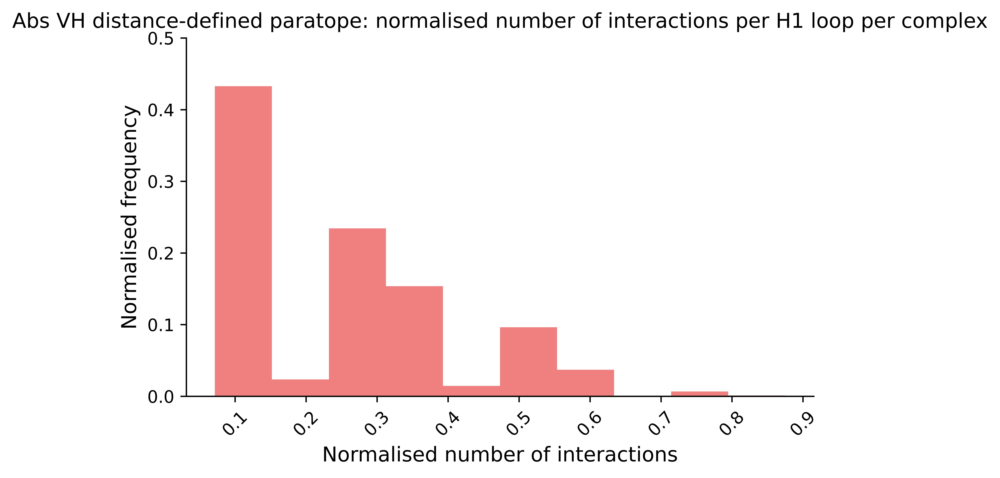

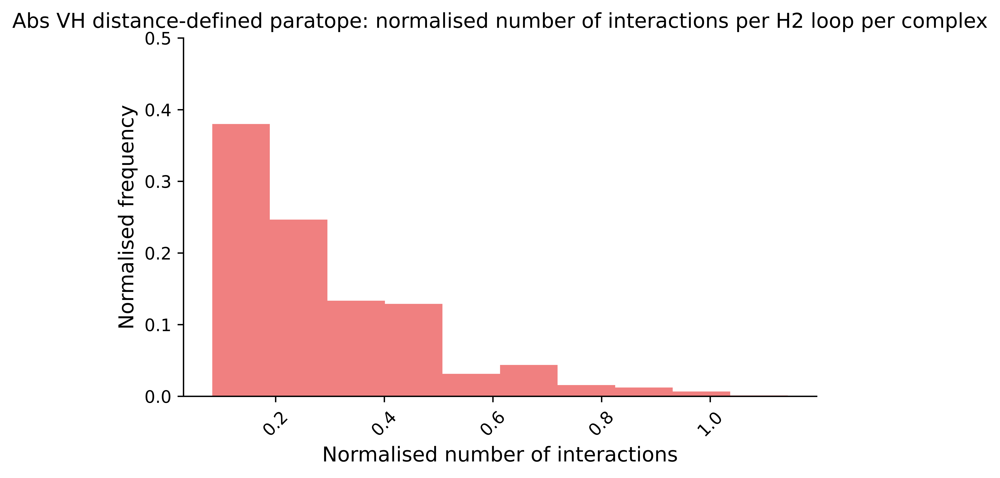

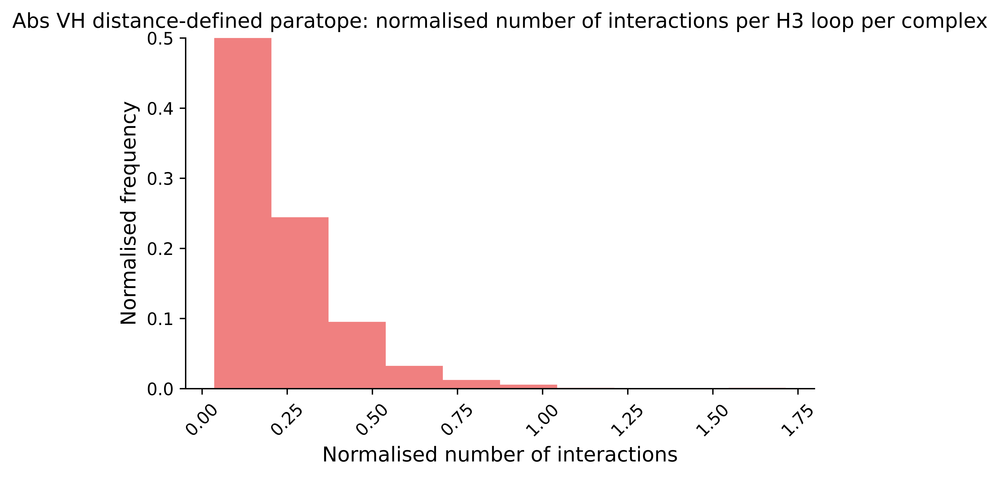

H1 0.2577293427431913
H2 0.29946837853227987
H3 0.21719938646608203


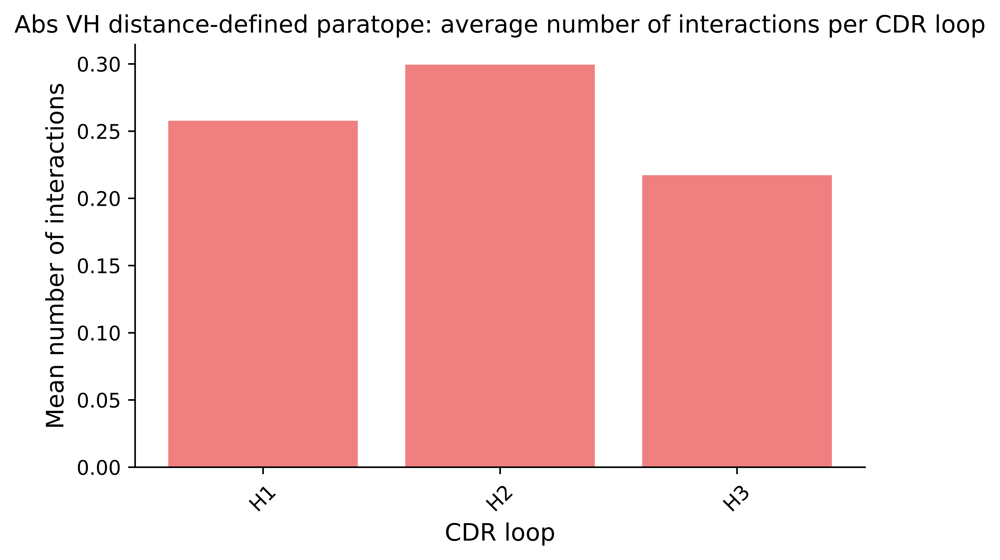

In [33]:
plot_normalised_per_complex(abs_dis_counts_vh, abs_cdr_lens, 'Abs VH distance-defined paratope', 'lightcoral', loops=['H1', 'H2', 'H3'])

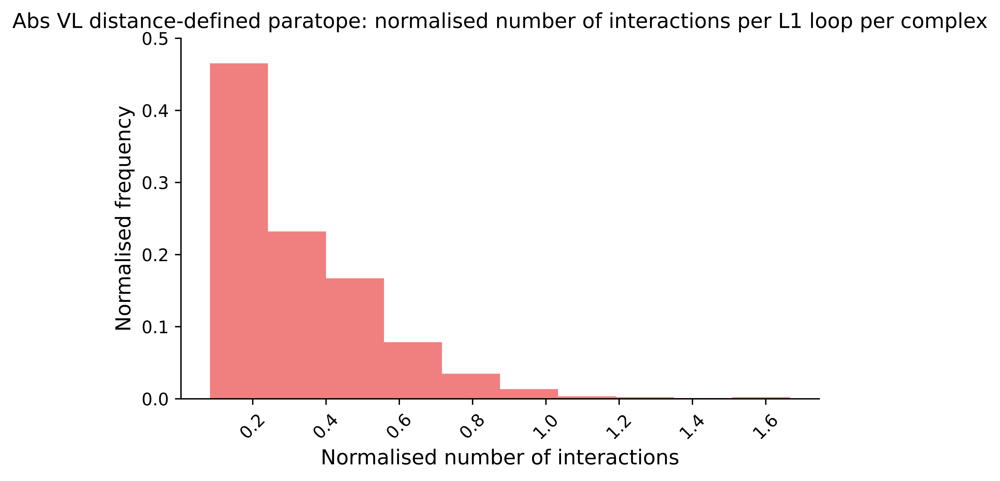

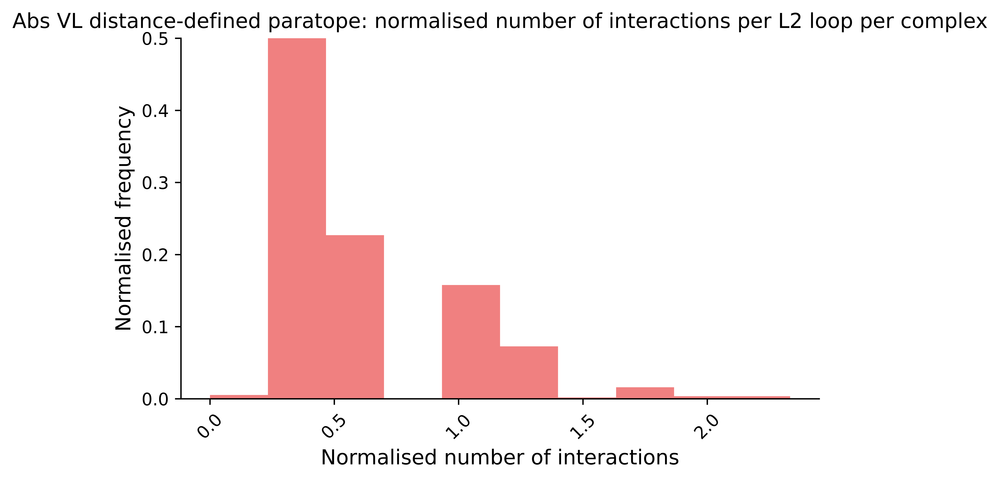

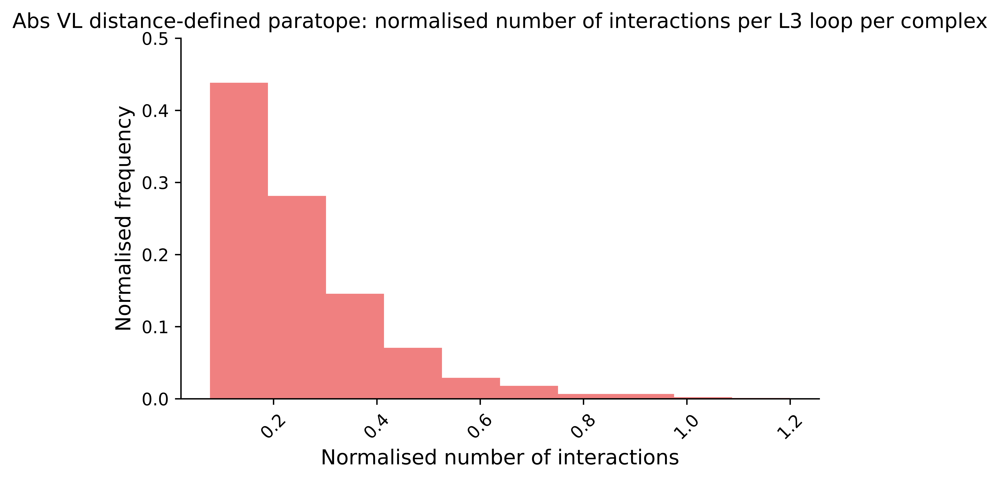

L1 0.3323047499336737
L2 0.6219499324552517
L3 0.24071462605655433


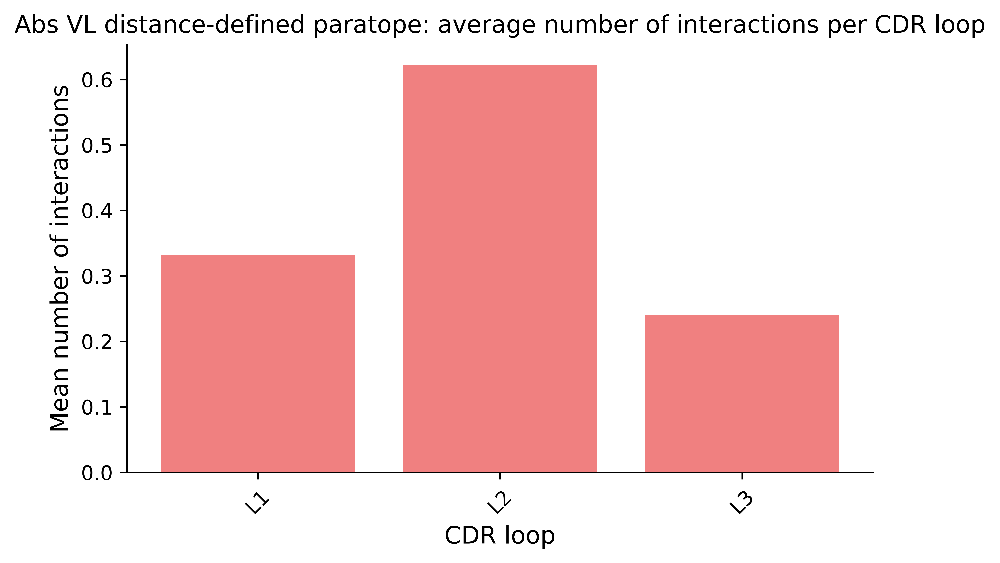

In [34]:
plot_normalised_per_complex(abs_dis_counts_vl, abs_cdr_lens, 'Abs VL distance-defined paratope', 'lightcoral', loops=['L1', 'L2', 'L3'])

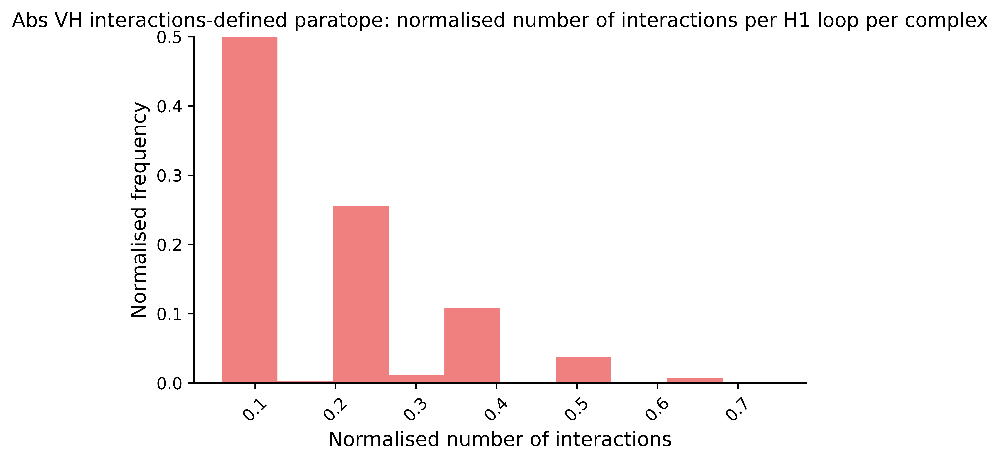

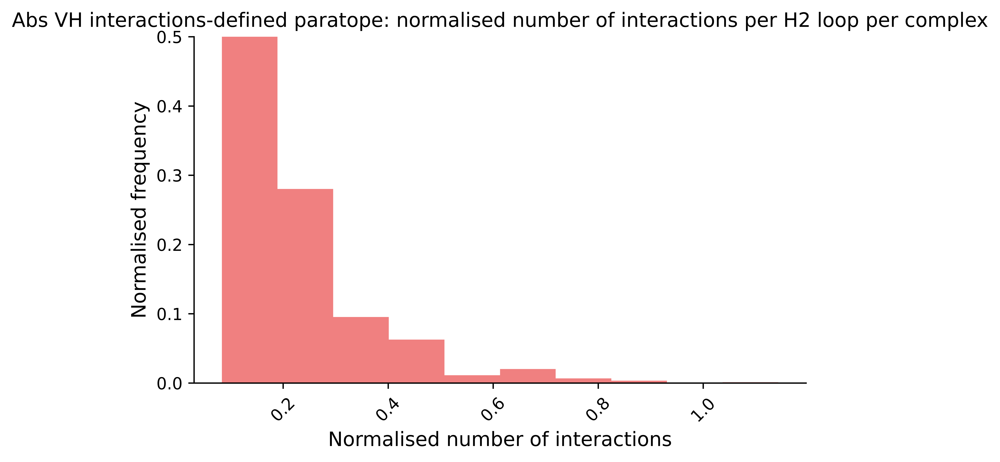

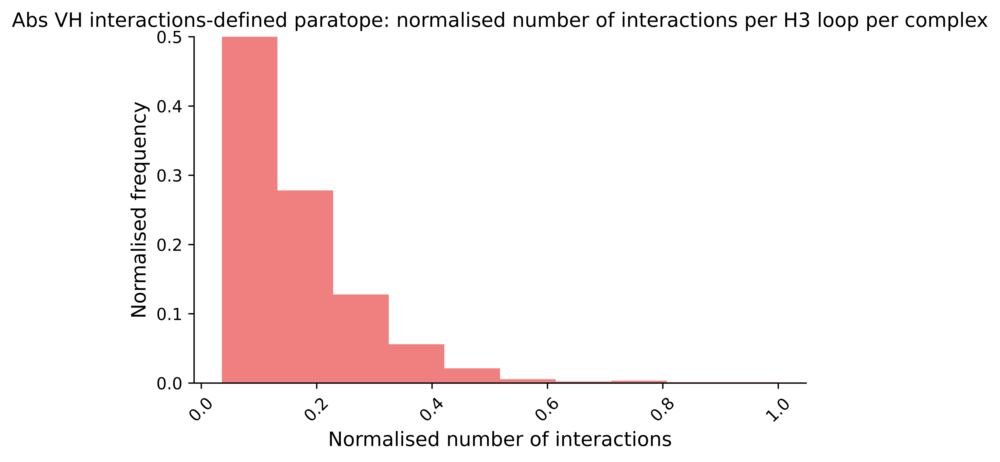

H1 0.20274640527707
H2 0.2324418108050395
H3 0.16084833181464472


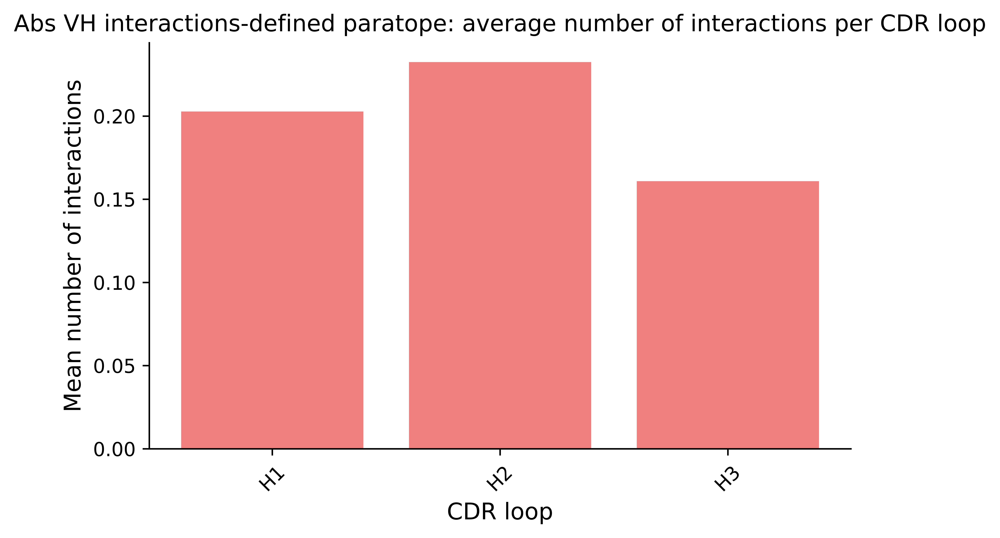

In [35]:
plot_normalised_per_complex(abs_arp_counts_vh, abs_cdr_lens, 'Abs VH interactions-defined paratope', 'lightcoral', loops=['H1', 'H2', 'H3'])

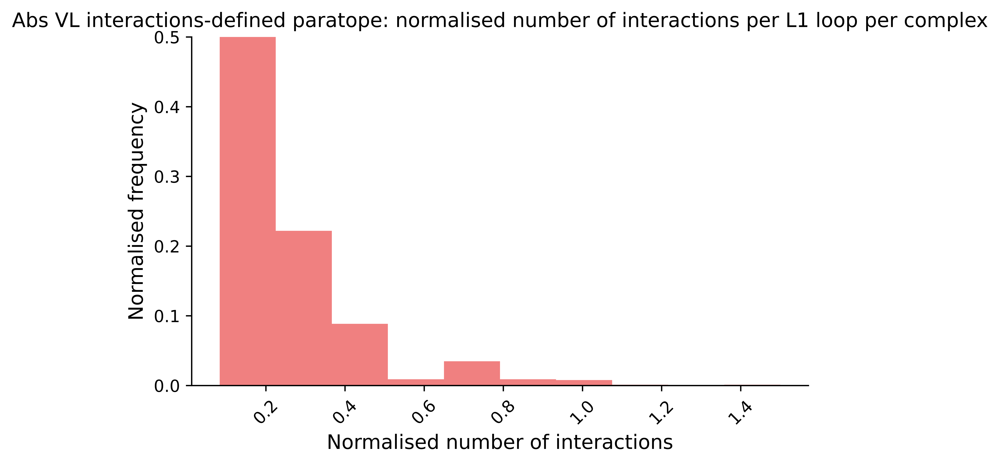

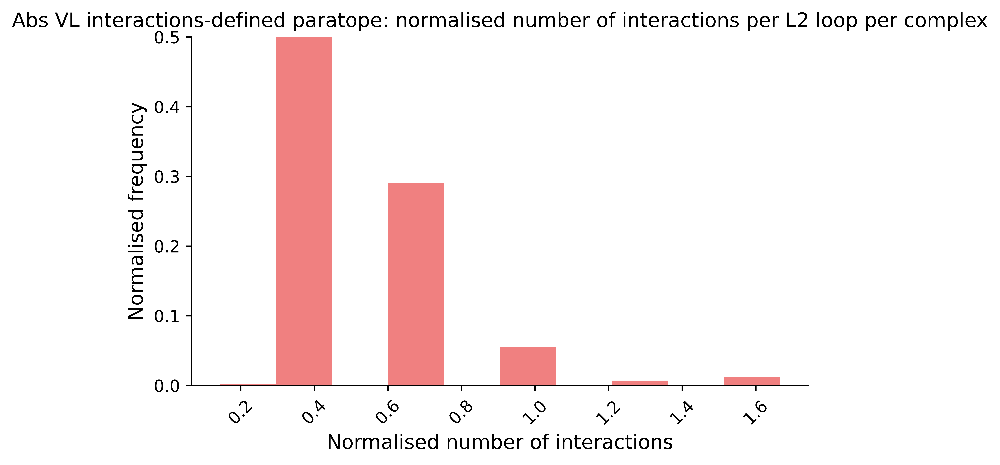

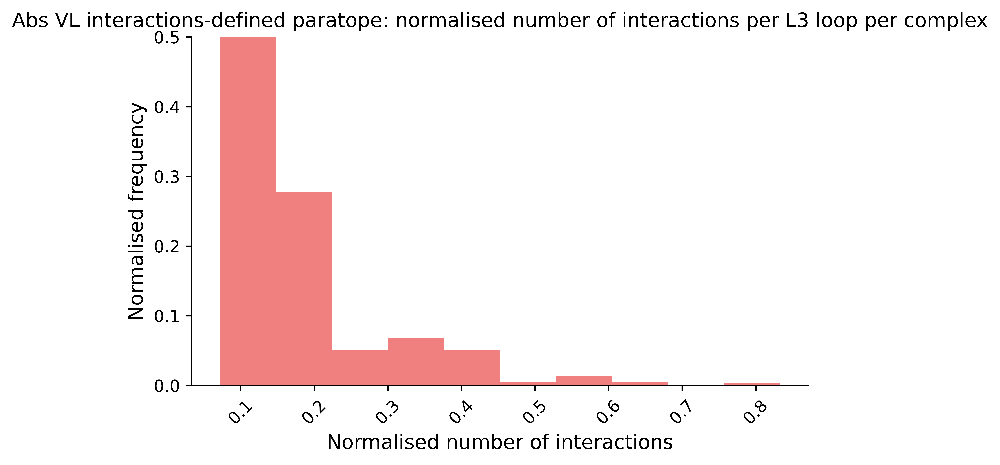

L1 0.2544487556539126
L2 0.48955121616992114
L3 0.18975878070609015


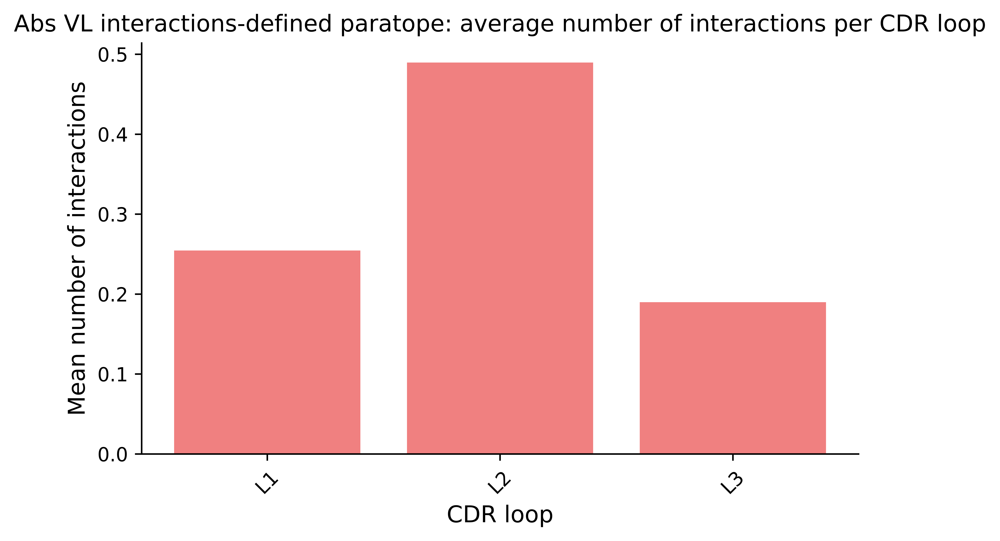

In [36]:
plot_normalised_per_complex(abs_arp_counts_vl, abs_cdr_lens, 'Abs VL interactions-defined paratope', 'lightcoral', loops=['L1', 'L2', 'L3'])

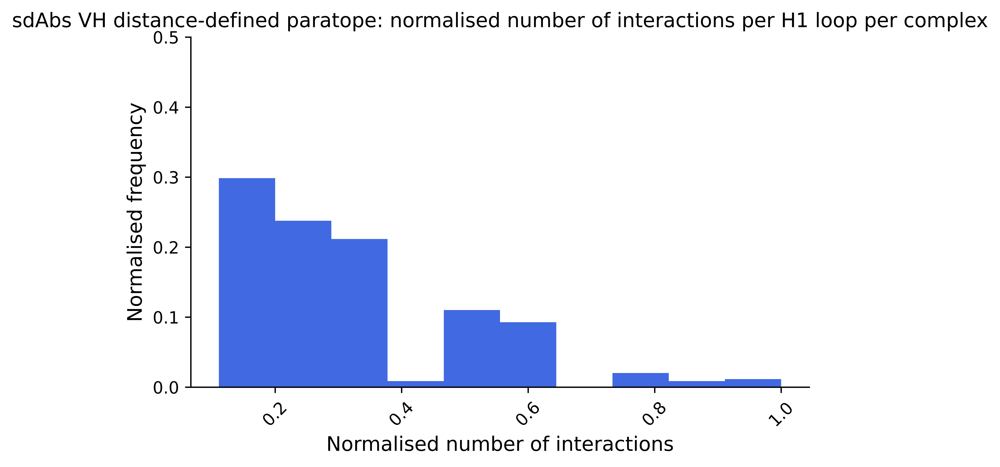

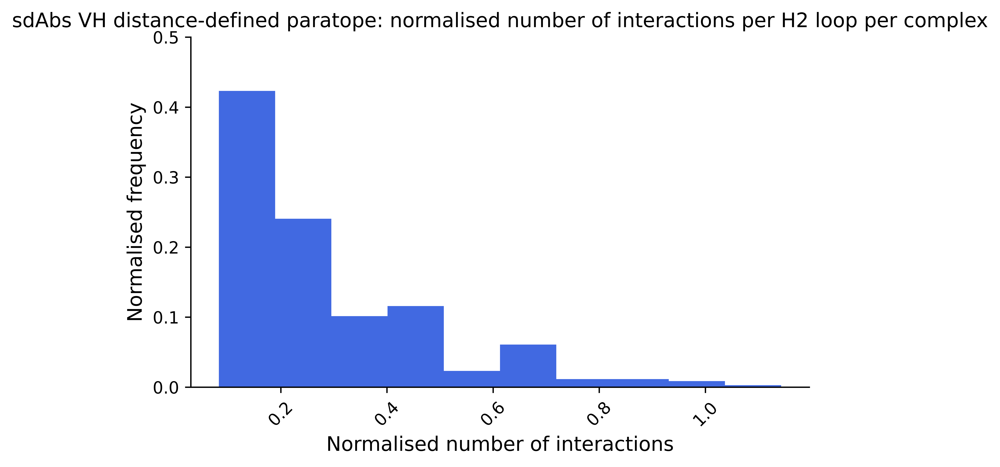

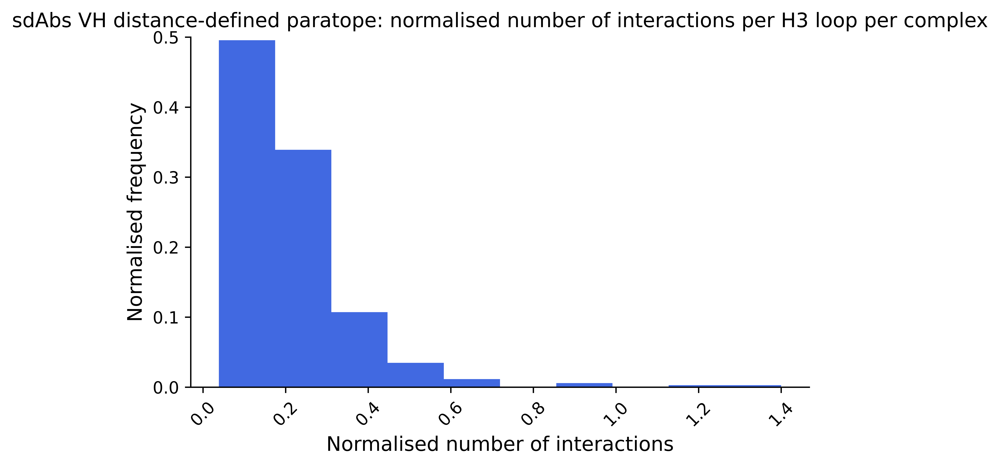

H1 0.32648224222594935
H2 0.29370600414078674
H3 0.199336918917385


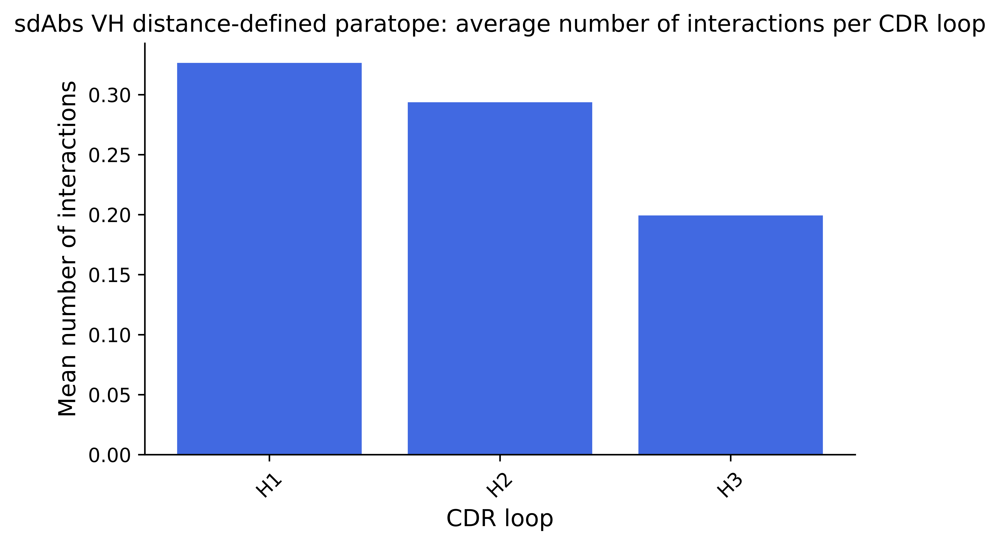

In [37]:
plot_normalised_per_complex(sdabs_dis_counts, sdabs_cdr_lens, 'sdAbs VH distance-defined paratope', 'royalblue', loops=['H1', 'H2', 'H3'])

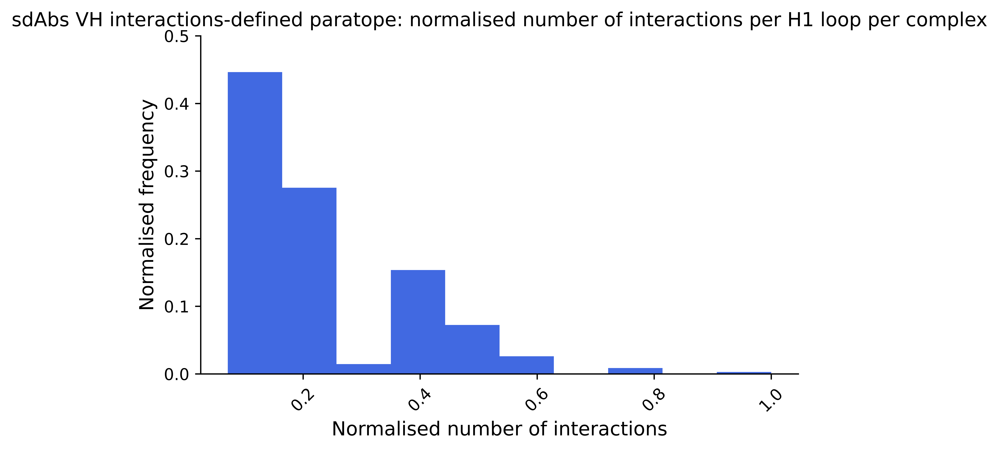

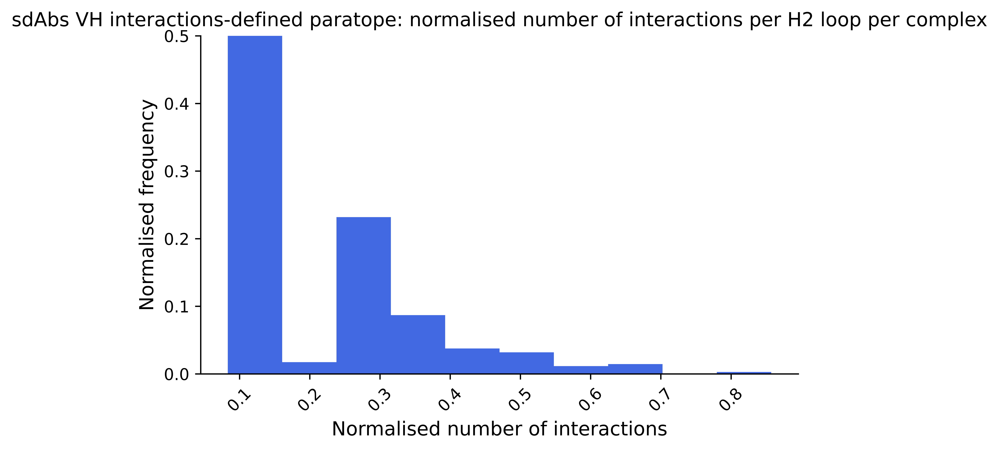

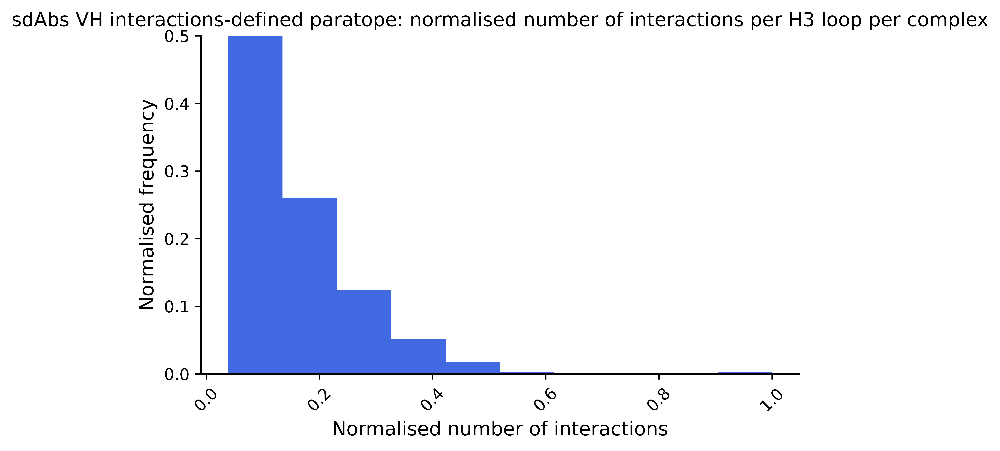

H1 0.2474270144636277
H2 0.22007131354957438
H3 0.15521448099062266


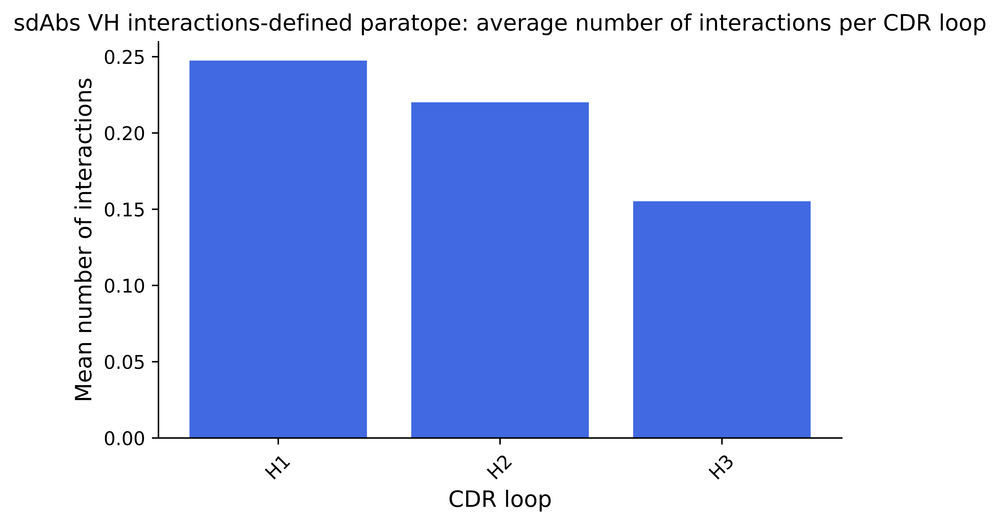

In [38]:
plot_normalised_per_complex(sdabs_arp_counts, sdabs_cdr_lens, 'sdAbs VH interactions-defined paratope', 'royalblue', loops=['H1', 'H2', 'H3'])

How often are no interactions contributed by a CDR loop? 

In [39]:
def count_zero_ints(dict_list, loop_defs, loops):
    # input list of loops (h1, h2, h3) or (l1, l2, l3)
    # return number of times a loop didn't contribute any interactions as a proportion of all complexes

    zero_cdr1, zero_cdr2, zero_cdr3 = 0,0,0
    for item in dict_list:
        cdr1_totals, cdr2_totals, cdr3_totals = [],[],[]
        for key, value in zip(item.keys(), item.values()):
            # for each entry in dict check if number in h1/h2/h3, if yes, add to total num interactions for that loop
            if key.split('_')[1] in loop_defs[loops[0]]:
                cdr1_totals.append(value)
            if key.split('_')[1] in loop_defs[loops[1]]:
                cdr2_totals.append(value)
            if key.split('_')[1] in loop_defs[loops[2]]:
                cdr3_totals.append(value)
        if len(cdr1_totals) == 0:
            zero_cdr1 += 1
        if len(cdr2_totals) == 0:
            zero_cdr2 += 1
        if len(cdr3_totals) == 0:
            zero_cdr3 += 1

    zero_cdr1_prop, zero_cdr2_prop, zero_cdr3_prop = [z/len(dict_list) for z in [zero_cdr1, zero_cdr2, zero_cdr3]]

    return {loops[0]: zero_cdr1_prop, loops[1]: zero_cdr2_prop, loops[2]: zero_cdr3_prop}

In [40]:
abs_dis_zero_vh = count_zero_ints(abs_ints_dis_vh, loop_defs, loops=['H1', 'H2', 'H3'])
abs_dis_zero_vl = count_zero_ints(abs_ints_dis_vl, loop_defs, loops=['L1', 'L2', 'L3'])

abs_arp_zero_vh = count_zero_ints(abs_ints_arp_vh, loop_defs, loops=['H1', 'H2', 'H3'])
abs_arp_zero_vl = count_zero_ints(abs_ints_arp_vl, loop_defs, loops=['L1', 'L2', 'L3'])

sdabs_dis_zero = count_zero_ints(sdabs_ints_dis, loop_defs, loops=['H1', 'H2', 'H3'])
sdabs_arp_zero = count_zero_ints(sdabs_ints_arp, loop_defs, loops=['H1', 'H2', 'H3'])

In [41]:
print(abs_dis_zero_vh)
print(abs_dis_zero_vl)
print(abs_arp_zero_vh)
print(abs_arp_zero_vl)
print(sdabs_dis_zero)
print(sdabs_arp_zero)

{'H1': 0.12331838565022421, 'H2': 0.08295964125560538, 'H3': 0.005605381165919282}
{'L1': 0.0930493273542601, 'L2': 0.5201793721973094, 'L3': 0.1210762331838565}
{'H1': 0.18202247191011237, 'H2': 0.12247191011235956, 'H3': 0.011235955056179775}
{'L1': 0.19325842696629214, 'L2': 0.6134831460674157, 'L3': 0.16292134831460675}
{'H1': 0.17971014492753623, 'H2': 0.19420289855072465, 'H3': 0.011594202898550725}
{'H1': 0.23478260869565218, 'H2': 0.25217391304347825, 'H3': 0.014492753623188406}


In [42]:
def plot_zeros_per_cdr(results_zero, loops, title, color):

    plt.figure()
    plt.title(str(title + ': normalised frequency of occurrences where a CDR loop contributed 0 interactions'))
    values = list(results_zero.values())
    print(values)
    plt.bar(range(len(results_zero)), values, tick_label=list(results_zero.keys()), color=color)
    plt.xticks(rotation=45)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.ylabel('Normalised frequency')
    plt.xlabel('CDR loop')
    plt.show()

    return 

In [43]:
plot_zeros_per_cdr(abs_dis_zero_vh, loops=['H1','H2','H3'], title='Abs VH distance-defined paratope', color='lightcoral')
plot_zeros_per_cdr(abs_dis_zero_vl, loops=['L1','L2','L3'], title='Abs VL distance-defined paratope', color='lightcoral')
plot_zeros_per_cdr(abs_arp_zero_vh, loops=['H1','H2','H3'], title='Abs VH interactions-defined paratope', color='lightcoral')
plot_zeros_per_cdr(abs_arp_zero_vl, loops=['L1','L2','L3'], title='Abs VL interactions-defined paratope', color='lightcoral')
plot_zeros_per_cdr(sdabs_dis_zero, loops=['H1','H2','H3'], title='sdAbs distance-defined paratope', color='royalblue')
plot_zeros_per_cdr(sdabs_arp_zero, loops=['H1','H2','H3'], title='sdAbs interactions-defined paratope', color='royalblue')

[0.12331838565022421, 0.08295964125560538, 0.005605381165919282]


[0.0930493273542601, 0.5201793721973094, 0.1210762331838565]


[0.18202247191011237, 0.12247191011235956, 0.011235955056179775]


[0.19325842696629214, 0.6134831460674157, 0.16292134831460675]


[0.17971014492753623, 0.19420289855072465, 0.011594202898550725]


[0.23478260869565218, 0.25217391304347825, 0.014492753623188406]
